<a href="https://colab.research.google.com/github/just-suraj-j/BITS-Pilani-Dissertation/blob/main/Identification_of_tasks.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

<img src = "https://www.bits-pilani.ac.in/Uploads/Campus/BITS_university_logo.gif">

<h1><center>Work Integrated Learning Programmes Division<br>
M.Tech (Data Science and Engineering)<br> 

## **Data Science for prevention of catastrophic occupational Injury** <br>
Name: Suraj Kumar Jha <br>
BITS ID: 2020sc04853 

## **Objective** <br>


### Identification of task performed by worker from images.
<br>

The ‘Hard Hat’ dataset of workers in workplace settings, provided by Northeastern
University, China. Would be used to identification of tasks. <br><br>

**Data source** <br><br>
https://dataverse.harvard.edu/dataset.xhtml?persistentId=doi:10.7910/DVN/7CBGOS

<br>
<img src="https://makeml.app/img/datasets/hat-workers/hat-workers-dataset3.png">




**Data Science** <br><br>
The accelerating volume of data sources, and subsequently data, has made data science is
one of the fastest growing fields across every industry. Organizations are increasingly
reliant on them to interpret data and provide actionable recommendations to improve
business outcomes.<br><br>
Data science combines math and statistics, specialized programming, advanced analytics,
artificial intelligence (AI), and machine learning with specific subject matter expertise to
uncover actionable insights hidden in an organization’s data. These insights can be used to
guide decision making and strategic planning.

**Computer vision** <br><br>
Computer vision works much the same as human vision, except humans have a head start.
Human sight has the advantage of lifetimes of context to train how to tell objects apart, how
far away they are, whether they are moving and whether there is something wrong in an
image.<br><br>
Computer vision is a field of artificial intelligence (AI) that enables computers and systems to
derive meaningful information from digital images, videos, and other visual inputs — and take
actions or make recommendations based on that information. If AI enables computers to
think, computer vision enables them to see, observe and understand

**Deep learning** <br><br>
Deep learning drives many artificial intelligence (AI) applications and services that improve
automation, performing analytical and physical tasks without human intervention. <br><br>
Deep learning is a subset of machine learning, which is essentially a neural network with three
or more layers. These neural networks attempt to simulate the behavior of the human brain—
albeit far from matching its ability—allowing it to “learn” from large amounts of data. While a
neural network with a single layer can still make approximate predictions, additional hidden
layers can help to optimize and refine for accuracy.

### **Mount Google Drive to get the stored images and captions**

In [ ]:
#Connect to Google drive to fetch data
from google.colab import drive
drive.mount("/content/gdrive")

Mounted at /content/gdrive


### **Importing required libraries**

In [ ]:
#Import required libraries
import os
import re
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers
from tensorflow.keras.preprocessing.image import load_img, img_to_array
from tensorflow.keras.applications import vgg16
from tensorflow.keras.applications import vgg19
from tensorflow.keras.applications import resnet50
from tensorflow.keras.applications import inception_v3
from tensorflow.keras.applications import efficientnet
from tensorflow.keras.applications import xception
from tensorflow.keras.layers import TextVectorization


### **Set Parameters and values**

In [ ]:
# Path to the images from Hardhat dataset
FILE_PATH = "/content/gdrive/MyDrive/Dissertation/Hardhat/Hardhat/Train/Images"
TOKENS_PATH="/content/gdrive/MyDrive/Dissertation/Hardhat/Hardhat/Train/Caption/hardhattoken.txt"

# Set desired image dimensions
IMG_SIZE = (256, 256)

# Set vocabulary size
VOCAB_SIZE = 1000

# Set fixed length allowed for any sequence
SEQ_LENGTH = 25

# Set dimension for the image embeddings and token embeddings
EMBED_DIM = 512

# Set per-layer units in the feed-forward network
FF_DIM = 512

# Set other training parameters
BATCH_SIZE = 64
EPOCHS = 15
AUTOTUNE = tf.data.AUTOTUNE
seed = 111
np.random.seed(seed)
tf.random.set_seed(seed)

### **Loading Images and Task Description**

In [ ]:
#Declare dictionary and list to store tasks and sequence
caption_mapping = {}
text_data = []

#Open filepath to read each line
with open(TOKENS_PATH) as caption_file:
        caption_data = caption_file.readlines()

#Read the data and identify predefined tasks for each image
for line in caption_data:
  line = line.rstrip("\n")
  img_name, caption = line.split("     ")
  img_name = img_name.split("#")[0]
  img_name = os.path.join(FILE_PATH, img_name.strip())
  tokens = caption.strip().split()
  if img_name.endswith("jpg") :
    caption = "<start> " + caption.strip() + " <end>"
    text_data.append(caption)
    if img_name in caption_mapping:
      caption_mapping[img_name].append(caption)
    else:
      caption_mapping[img_name] = [caption]


### **Display images with task description sequence**

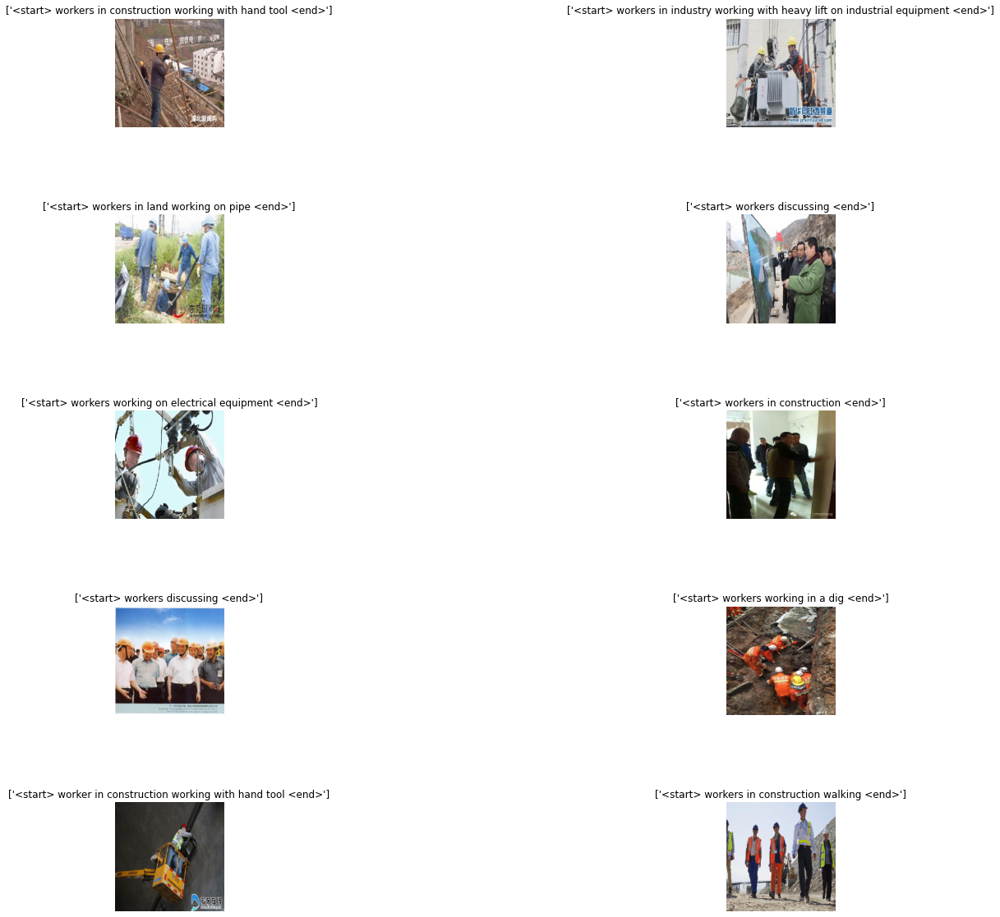

In [ ]:
count=0
n=0
plt.figure(figsize = (20 , 20))
for i in caption_mapping.keys():
  if count<10:
    n+=1
    plt.subplot(5 , 2, n)
    plt.subplots_adjust(hspace = 0.8, wspace = 1)
    img = load_img(i,color_mode='rgb',target_size=(299,299))
    plt.title(caption_mapping[i])
    img = img_to_array(img)
    img = img/255.
    plt.imshow(img)
    plt.axis("off")
    count=count+1

### **Data Preparation for Training and Validation**

In [ ]:
#Split training and validation data
def training_val_split(caption_data, train_size=0.80, shuffle=True):
    imageList = list(caption_data.keys())
    if shuffle:
        np.random.shuffle(imageList)
    training_size = int(len(caption_data) * train_size)

    training_data = {
        img_name: caption_data[img_name] for img_name in imageList[:training_size]
    }
    validation_data = {
        img_name: caption_data[img_name] for img_name in imageList[training_size:]
    }
    return training_data, validation_data

# Split the dataset into training and validation sets
train_data, valid_data = training_val_split(caption_mapping)
print("Number of training samples: ", len(train_data))
print("Number of validation samples: ", len(valid_data))

Number of training samples:  3200
Number of validation samples:  800


In [ ]:
#preprocessing of text data
def custom_standard(input):
  lower=tf.strings.lower(input)
  custom = tf.strings.regex_replace(lower, '<','')
  custom = tf.strings.regex_replace(custom, '>','')
  return custom

vectorize = TextVectorization(
    max_tokens=VOCAB_SIZE,
    output_mode="int",
    output_sequence_length=SEQ_LENGTH,
    standardize=custom_standard,
)
vectorize.adapt(text_data)

# Data augmentation for image data
image_augmentation = keras.Sequential(
    [
        layers.RandomFlip("horizontal"),
        layers.RandomRotation(0.2),
        layers.RandomContrast(0.3),
    ]
)


In [ ]:
#Prepare training and validation data
def process_input(img_path, captions):
    img = tf.io.read_file(img_path)
    img = tf.image.decode_jpeg(img, channels=3)
    img = tf.image.resize(img,IMG_SIZE)
    img = tf.image.convert_image_dtype(img, tf.float32)
    cap=vectorize(captions)
    return img,cap 


def make_dataset(images, captions):
    dataset = tf.data.Dataset.from_tensor_slices((images, captions))
    dataset = dataset.shuffle(BATCH_SIZE * 8)
    dataset = dataset.map(process_input, num_parallel_calls=AUTOTUNE)
    dataset = dataset.batch(BATCH_SIZE).prefetch(AUTOTUNE)
    return dataset


# Pass the list of images and the list of corresponding captions
train_dataset = make_dataset(list(train_data.keys()), list(train_data.values()))

valid_dataset = make_dataset(list(valid_data.keys()), list(valid_data.values()))

### **Defining Transformer Encoder and Decoder Architecture**

<img src="https://i0.wp.com/kikaben.com/wp-content/uploads/2022/04/image-424.png?w=800&ssl=1">

<img src="https://i0.wp.com/kikaben.com/wp-content/uploads/2022/04/image-425.png?w=800&ssl=1">

<img src="https://i0.wp.com/kikaben.com/wp-content/uploads/2022/04/image-429.png?w=800&ssl=1">

<img src="https://i0.wp.com/kikaben.com/wp-content/uploads/2022/04/image-449.png?w=800&ssl=1">

In [ ]:
class TransformerEncoder(layers.Layer):
    def __init__(self, embed_dim, dense_dim, num_heads, **kwargs):
        super().__init__(**kwargs)
        self.embed_dim = embed_dim
        self.dense_dim = dense_dim
        self.num_heads = num_heads
        self.attention_1 = layers.MultiHeadAttention(
            num_heads=num_heads, key_dim=embed_dim, dropout=0.0
        )
        self.layernorm_1 = layers.LayerNormalization()
        self.layernorm_2 = layers.LayerNormalization()
        self.dense_1 = layers.Dense(embed_dim, activation="relu")

    def call(self, inputs, training, mask=None):
        inputs = self.layernorm_1(inputs)
        inputs = self.dense_1(inputs)

        attention_output_1 = self.attention_1(
            query=inputs,
            value=inputs,
            key=inputs,
            attention_mask=None,
            training=training,
        )
        out_1 = self.layernorm_2(inputs + attention_output_1)
        return out_1


class PositionalEmbed(layers.Layer):
    def __init__(self, sequence_length, vocab_size, embed_dim, **kwargs):
        super().__init__(**kwargs)
        self.token_embeddings = layers.Embedding(
            input_dim=vocab_size, output_dim=embed_dim
        )
        self.position_embeddings = layers.Embedding(
            input_dim=sequence_length, output_dim=embed_dim
        )
        self.sequence_length = sequence_length
        self.vocab_size = vocab_size
        self.embed_dim = embed_dim
        self.embed_scale = tf.math.sqrt(tf.cast(embed_dim, tf.float32))

    def call(self, inputs):
        length = tf.shape(inputs)[-1]
        positions = tf.range(start=0, limit=length, delta=1)
        embedded_tokens = self.token_embeddings(inputs)
        embedded_tokens = embedded_tokens * self.embed_scale
        embedded_positions = self.position_embeddings(positions)
        return embedded_tokens + embedded_positions

    def compute_mask(self, inputs, mask=None):
        return tf.math.not_equal(inputs, 0)


class TransformerDecoder(layers.Layer):
    def __init__(self, embed_dim, ff_dim, num_heads, **kwargs):
        super().__init__(**kwargs)
        self.embed_dim = embed_dim
        self.ff_dim = ff_dim
        self.num_heads = num_heads
        self.attention_1 = layers.MultiHeadAttention(
            num_heads=num_heads, key_dim=embed_dim, dropout=0.1
        )
        self.attention_2 = layers.MultiHeadAttention(
            num_heads=num_heads, key_dim=embed_dim, dropout=0.1
        )
        self.ffn_layer_1 = layers.Dense(ff_dim, activation="relu")
        self.ffn_layer_2 = layers.Dense(embed_dim)

        self.layernorm_1 = layers.LayerNormalization()
        self.layernorm_2 = layers.LayerNormalization()
        self.layernorm_3 = layers.LayerNormalization()

        self.embedding = PositionalEmbed(
            embed_dim=EMBED_DIM, sequence_length=SEQ_LENGTH, vocab_size=VOCAB_SIZE
        )
        self.out = layers.Dense(VOCAB_SIZE, activation="softmax")

        self.dropout_1 = layers.Dropout(0.3)
        self.dropout_2 = layers.Dropout(0.5)
        self.supports_masking = True

    def call(self, inputs, encoder_outputs, training, mask=None):
        inputs = self.embedding(inputs)
        causal_mask = self.get_causal_attention_mask(inputs)

        if mask is not None:
            padding_mask = tf.cast(mask[:, :, tf.newaxis], dtype=tf.int32)
            combined_mask = tf.cast(mask[:, tf.newaxis, :], dtype=tf.int32)
            combined_mask = tf.minimum(combined_mask, causal_mask)

        attention_output_1 = self.attention_1(
            query=inputs,
            value=inputs,
            key=inputs,
            attention_mask=combined_mask,
            training=training,
        )
        out_1 = self.layernorm_1(inputs + attention_output_1)

        attention_output_2 = self.attention_2(
            query=out_1,
            value=encoder_outputs,
            key=encoder_outputs,
            attention_mask=padding_mask,
            training=training,
        )
        out_2 = self.layernorm_2(out_1 + attention_output_2)

        ffn_out = self.ffn_layer_1(out_2)
        ffn_out = self.dropout_1(ffn_out, training=training)
        ffn_out = self.ffn_layer_2(ffn_out)

        ffn_out = self.layernorm_3(ffn_out + out_2, training=training)
        ffn_out = self.dropout_2(ffn_out, training=training)
        preds = self.out(ffn_out)
        return preds

    def get_causal_attention_mask(self, inputs):
        input_shape = tf.shape(inputs)
        batch_size, sequence_length = input_shape[0], input_shape[1]
        i = tf.range(sequence_length)[:, tf.newaxis]
        j = tf.range(sequence_length)
        mask = tf.cast(i >= j, dtype="int32")
        mask = tf.reshape(mask, (1, input_shape[1], input_shape[1]))
        mult = tf.concat(
            [tf.expand_dims(batch_size, -1), tf.constant([1, 1], dtype=tf.int32)],
            axis=0,
        )
        return tf.tile(mask, mult)

In [ ]:
class TaskIdentification(keras.Model):
    def __init__(
        self, cnn_model, encoder, decoder, num_captions_per_image=1, image_aug=None,
    ):
        super().__init__()
        self.cnn_model = cnn_model
        self.encoder = encoder
        self.decoder = decoder
        self.loss_tracker = keras.metrics.Mean(name="loss")
        self.acc_tracker = keras.metrics.Mean(name="accuracy")
        self.num_captions_per_image = num_captions_per_image
        self.image_aug = image_aug

    def calculate_loss(self, y_true, y_pred, mask):
        loss = self.loss(y_true, y_pred)
        mask = tf.cast(mask, dtype=loss.dtype)
        loss *= mask
        return tf.reduce_sum(loss) / tf.reduce_sum(mask)

    def calculate_accuracy(self, y_true, y_pred, mask):
        accuracy = tf.equal(y_true, tf.argmax(y_pred, axis=2))
        accuracy = tf.math.logical_and(mask, accuracy)
        accuracy = tf.cast(accuracy, dtype=tf.float32)
        mask = tf.cast(mask, dtype=tf.float32)
        return tf.reduce_sum(accuracy) / tf.reduce_sum(mask)

    def _compute_caption_loss_and_acc(self, img_embed, batch_seq, training=True):
        encoder_out = self.encoder(img_embed, training=training)
        batch_seq_inp = batch_seq[:, :-1]
        batch_seq_true = batch_seq[:, 1:]
        mask = tf.math.not_equal(batch_seq_true, 0)
        batch_seq_pred = self.decoder(
            batch_seq_inp, encoder_out, training=training, mask=mask
        )
        loss = self.calculate_loss(batch_seq_true, batch_seq_pred, mask)
        acc = self.calculate_accuracy(batch_seq_true, batch_seq_pred, mask)
        return loss, acc

    def train_step(self, batch_data):
        batch_img, batch_seq = batch_data
        batch_loss = 0
        batch_acc = 0

        if self.image_aug:
            batch_img = self.image_aug(batch_img)

        # 1. Get image embeddings
        img_embed = self.cnn_model(batch_img)

        # 2. Pass each of the five captions one by one to the decoder
        # along with the encoder outputs and compute the loss as well as accuracy
        # for each caption.
        for i in range(self.num_captions_per_image):
            with tf.GradientTape() as tape:
                loss, acc = self._compute_caption_loss_and_acc(
                    img_embed, batch_seq[:, i, :], training=True
                )

                # 3. Update loss and accuracy
                batch_loss += loss
                batch_acc += acc

            # 4. Get the list of all the trainable weights
            train_vars = (
                self.encoder.trainable_variables + self.decoder.trainable_variables
            )

            # 5. Get the gradients
            grads = tape.gradient(loss, train_vars)

            # 6. Update the trainable weights
            self.optimizer.apply_gradients(zip(grads, train_vars))

        # 7. Update the trackers
        batch_acc /= float(self.num_captions_per_image)
        self.loss_tracker.update_state(batch_loss)
        self.acc_tracker.update_state(batch_acc)

        # 8. Return the loss and accuracy values
        return {"loss": self.loss_tracker.result(), "acc": self.acc_tracker.result()}

    def test_step(self, batch_data):
        batch_img, batch_seq = batch_data
        batch_loss = 0
        batch_acc = 0

        # 1. Get image embeddings
        img_embed = self.cnn_model(batch_img)

        # 2. Pass each of the five captions one by one to the decoder
        # along with the encoder outputs and compute the loss as well as accuracy
        # for each caption.
        for i in range(self.num_captions_per_image):
            loss, acc = self._compute_caption_loss_and_acc(
                img_embed, batch_seq[:, i, :], training=False
            )

            # 3. Update batch loss and batch accuracy
            batch_loss += loss
            batch_acc += acc

        batch_acc /= float(self.num_captions_per_image)

        # 4. Update the trackers
        self.loss_tracker.update_state(batch_loss)
        self.acc_tracker.update_state(batch_acc)

        # 5. Return the loss and accuracy values
        return {"loss": self.loss_tracker.result(), "acc": self.acc_tracker.result()}

    @property
    def metrics(self):
        # We need to list our metrics here so the `reset_states()` can be
        # called automatically.
        return [self.loss_tracker, self.acc_tracker]

In [ ]:
# Define the loss function
cross_entropy = keras.losses.SparseCategoricalCrossentropy(
    from_logits=False, reduction="none"
)

# EarlyStopping criteria
early_stopping = keras.callbacks.EarlyStopping(patience=3, restore_best_weights=True)


# Learning Rate Scheduler for the optimizer
class LearnRateSchedule(keras.optimizers.schedules.LearningRateSchedule):
    def __init__(self, post_warmup_learning_rate, warmup_steps):
        super().__init__()
        self.post_warmup_learning_rate = post_warmup_learning_rate
        self.warmup_steps = warmup_steps

    def __call__(self, step):
        global_step = tf.cast(step, tf.float32)
        warmup_steps = tf.cast(self.warmup_steps, tf.float32)
        warmup_progress = global_step / warmup_steps
        warmup_learning_rate = self.post_warmup_learning_rate * warmup_progress
        return tf.cond(
            global_step < warmup_steps,
            lambda: warmup_learning_rate,
            lambda: self.post_warmup_learning_rate,
        )


# Create a learning rate schedule
num_train_steps = len(train_dataset) * EPOCHS
num_warmup_steps = num_train_steps // 15
lr_schedule = LearnRateSchedule(post_warmup_learning_rate=1e-4, warmup_steps=num_warmup_steps)

In [ ]:
vocab = vectorize.get_vocabulary()
index_lookup = dict(zip(range(len(vocab)), vocab))
max_decoded_sentence_length = SEQ_LENGTH - 1
valid_images = list(valid_data.keys())

def generate_caption():
    # Select a random image from the validation dataset
    sample_img = np.random.choice(valid_images)

    # Read the image from the disk
    read_img = tf.io.read_file(sample_img)
    dec_img = tf.image.decode_jpeg(read_img, channels=3)
    res_img = tf.image.resize(dec_img,IMG_SIZE)
    sample_img = tf.image.convert_image_dtype(res_img, tf.float32)
    img = sample_img.numpy().clip(0, 255).astype(np.uint8)
    plt.imshow(img)
    plt.show()

    # Pass the image to the CNN
    img = tf.expand_dims(sample_img, 0)
    img = caption_model.cnn_model(img)

    # Pass the image features to the Transformer encoder
    encoded_img = caption_model.encoder(img, training=False)

    # Generate the caption using the Transformer decoder
    decoded_caption = "<start> "
    for i in range(max_decoded_sentence_length):
        tokenized_caption = vectorize([decoded_caption])[:, :-1]
        mask = tf.math.not_equal(tokenized_caption, 0)
        predictions = caption_model.decoder(
            tokenized_caption, encoded_img, training=False, mask=mask
        )
        sampled_token_index = np.argmax(predictions[0, i, :])
        sampled_token = index_lookup[sampled_token_index]
        if sampled_token == "end":
            break
        decoded_caption += " " + sampled_token

    decoded_caption = decoded_caption.replace("<start> ", "")
    decoded_caption = decoded_caption.replace(" <end>", "").strip()
    print("Predicted task: ", decoded_caption)

In [ ]:
def plot_loss(title,history):
  plt.plot(history.history['loss'])
  plt.plot(history.history['val_loss'])
  plt.title(title)
  plt.ylabel('loss')
  plt.xlabel('epoch')
  plt.legend(['train', 'val'], loc='upper left')
  plt.show()
  return

def plot_accuracy(title,history):
  plt.plot(history.history['acc'])
  plt.plot(history.history['val_acc'])
  plt.title(title)
  plt.ylabel('accuracy')
  plt.xlabel('epoch')
  plt.legend(['train', 'val'], loc='upper left')
  plt.show()
  return


### **Implementing Transformer model with pretrained VGG16**

In [ ]:
def pretrained_vgg16():
    vgg = vgg16.VGG16(
        input_shape=(*IMG_SIZE, 3), include_top=False, weights="imagenet",
    )
    # We freeze our feature extractor
    vgg.trainable = False
    outputs = vgg.output
    outputs = layers.Reshape((-1, outputs.shape[-1]))(outputs)
    model = keras.models.Model(vgg.input, outputs)
    return model

In [ ]:
model = pretrained_vgg16()
encoder = TransformerEncoder(embed_dim=EMBED_DIM, dense_dim=FF_DIM, num_heads=1)
decoder = TransformerDecoder(embed_dim=EMBED_DIM, ff_dim=FF_DIM, num_heads=2)
caption_model = TaskIdentification(
    cnn_model=model, encoder=encoder, decoder=decoder, image_aug=image_augmentation,
)

58889256/58889256 [==============================] - 1s 0us/step


### **Model Evaluation**

In [ ]:
# Compile the model
caption_model.compile(optimizer=keras.optimizers.Adam(lr_schedule), loss=cross_entropy)

# Fit the model
history =caption_model.fit(
    train_dataset,
    epochs=EPOCHS,
    validation_data=valid_dataset,
    callbacks=[early_stopping],
)

Epoch 1/15


50/50 [==============================] - 536s 10s/step - loss: 4.7443 - acc: 0.0940 - val_loss: 1.5651 - val_acc: 0.6308
Epoch 2/15
50/50 [==============================] - 50s 992ms/step - loss: 1.2718 - acc: 0.6147 - val_loss: 0.7630 - val_acc: 0.7298
Epoch 3/15
50/50 [==============================] - 51s 1s/step - loss: 0.8727 - acc: 0.7022 - val_loss: 0.6555 - val_acc: 0.7466
Epoch 4/15
50/50 [==============================] - 50s 994ms/step - loss: 0.7582 - acc: 0.7319 - val_loss: 0.5730 - val_acc: 0.7783
Epoch 5/15
50/50 [==============================] - 50s 987ms/step - loss: 0.7097 - acc: 0.7415 - val_loss: 0.5499 - val_acc: 0.7927
Epoch 6/15
50/50 [==============================] - 50s 997ms/step - loss: 0.6513 - acc: 0.7674 - val_loss: 0.5323 - val_acc: 0.7904
Epoch 7/15
50/50 [==============================] - 55s 1s/step - loss: 0.6367 - acc: 0.7618 - val_loss: 0.5146 - val_acc: 0.8022
Epoch 8/15
50/50 [==============================] - 50s 992ms/step - loss: 0.6143 - acc

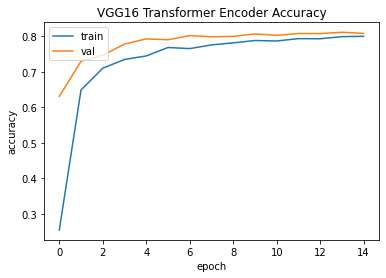

In [ ]:
plot_accuracy('VGG16 Transformer Encoder Accuracy',history)

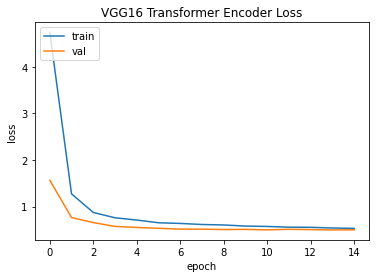

In [ ]:
plot_loss('VGG16 Transformer Encoder Loss',history)

### **Prediction Results**

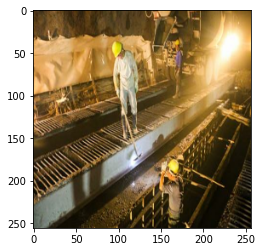

Predicted task:  workers in construction working


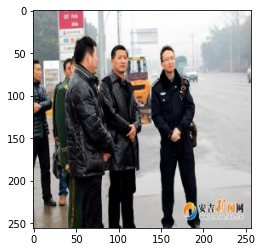

Predicted task:  workers standing


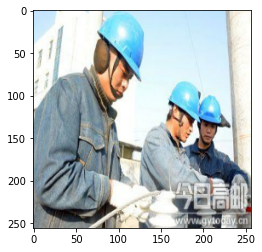

Predicted task:  workers working on electrical equipment


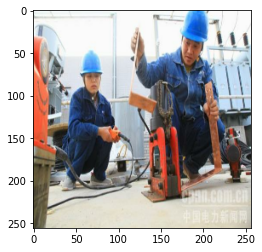

Predicted task:  workers in construction working


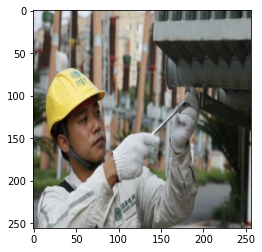

Predicted task:  workers discussing


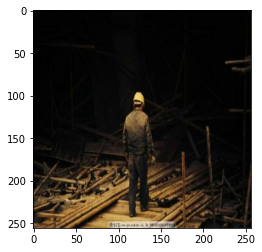

Predicted task:  worker standing


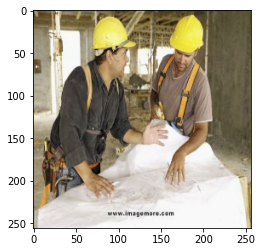

Predicted task:  workers discussing


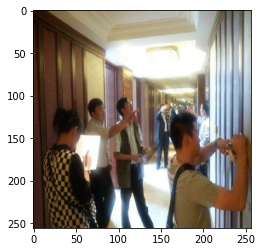

Predicted task:  workers discussing


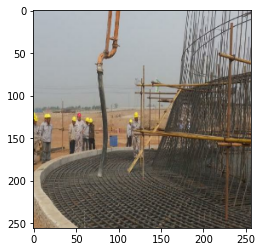

Predicted task:  workers in construction working


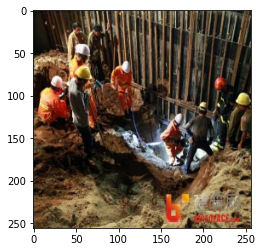

Predicted task:  workers discussing


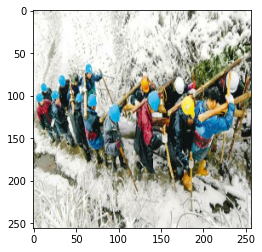

Predicted task:  workers working in a dig


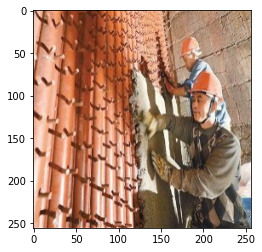

Predicted task:  worker standing


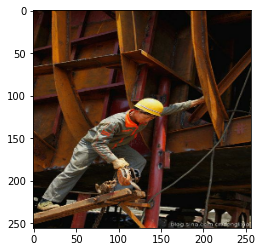

Predicted task:  worker in construction working


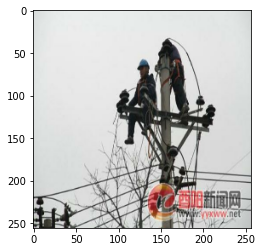

Predicted task:  workers working on electrical equipment


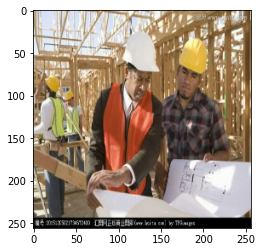

Predicted task:  workers discussing


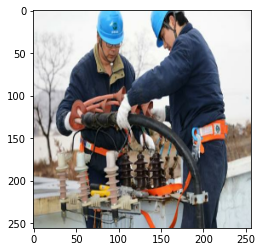

Predicted task:  workers working on electrical equipment


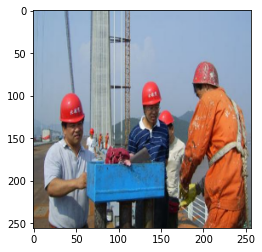

Predicted task:  workers discussing


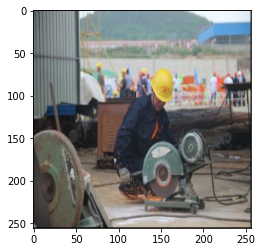

Predicted task:  workers working on industrial equipment


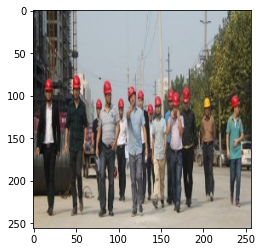

Predicted task:  workers discussing


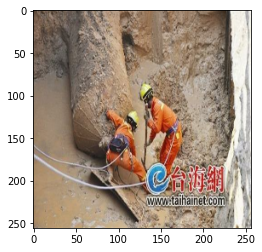

Predicted task:  workers working in a dig with hand tool


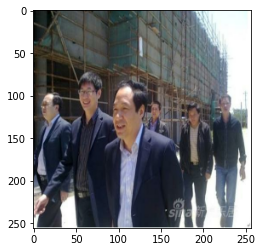

Predicted task:  workers discussing


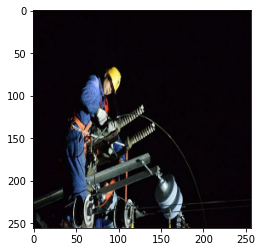

Predicted task:  workers working on electrical equipment


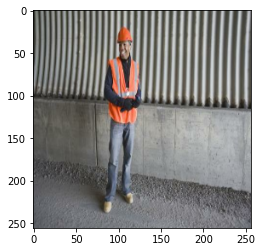

Predicted task:  workers standing


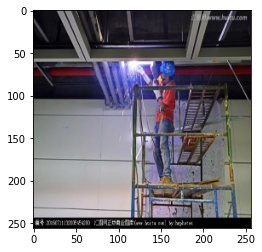

Predicted task:  worker working on electrical equipment


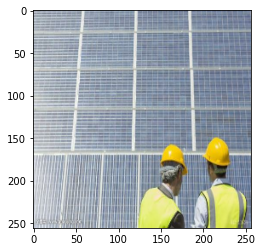

Predicted task:  workers discussing


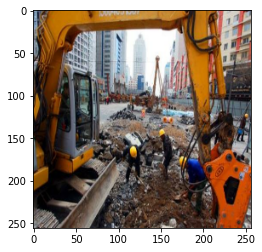

Predicted task:  workers working on industrial equipment


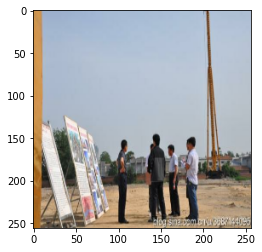

Predicted task:  workers standing


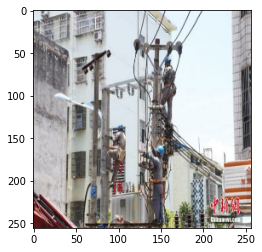

Predicted task:  workers working on electrical equipment


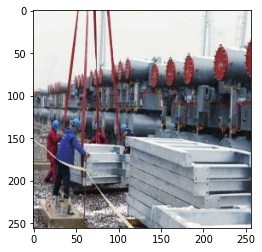

Predicted task:  workers discussing


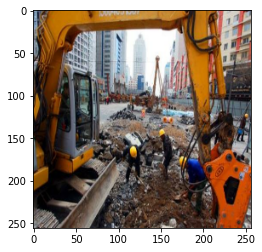

Predicted task:  workers working on industrial equipment


In [ ]:
# Check predictions for a few samples
for i in range(0,30):
  generate_caption()

### **Implementing Transformer model with pretrained VGG19**

In [ ]:
def pretrained_vgg19():
    vgg = vgg19.VGG19(
        input_shape=(*IMG_SIZE, 3), include_top=False, weights="imagenet",
    )
    # We freeze our feature extractor
    vgg.trainable = False
    outputs = vgg.output
    outputs = layers.Reshape((-1, outputs.shape[-1]))(outputs)
    model = keras.models.Model(vgg.input, outputs)
    return model

In [ ]:
model = pretrained_vgg19()
encoder = TransformerEncoder(embed_dim=EMBED_DIM, dense_dim=FF_DIM, num_heads=1)
decoder = TransformerDecoder(embed_dim=EMBED_DIM, ff_dim=FF_DIM, num_heads=2)
caption_model = TaskIdentification(
    cnn_model=model, encoder=encoder, decoder=decoder, image_aug=image_augmentation,
)

80134624/80134624 [==============================] - 0s 0us/step


In [ ]:
# Compile the model
caption_model.compile(optimizer=keras.optimizers.Adam(lr_schedule), loss=cross_entropy)

# Fit the model
history =caption_model.fit(
    train_dataset,
    epochs=EPOCHS,
    validation_data=valid_dataset,
    callbacks=[early_stopping],
)

Epoch 1/15


50/50 [==============================] - 61s 1s/step - loss: 4.8743 - acc: 0.0945 - val_loss: 1.6478 - val_acc: 0.5682
Epoch 2/15
50/50 [==============================] - 55s 1s/step - loss: 1.2893 - acc: 0.6232 - val_loss: 0.7705 - val_acc: 0.7519
Epoch 3/15
50/50 [==============================] - 55s 1s/step - loss: 0.8626 - acc: 0.6963 - val_loss: 0.6304 - val_acc: 0.7674
Epoch 4/15
50/50 [==============================] - 54s 1s/step - loss: 0.7451 - acc: 0.7350 - val_loss: 0.5710 - val_acc: 0.7772
Epoch 5/15
50/50 [==============================] - 56s 1s/step - loss: 0.7060 - acc: 0.7410 - val_loss: 0.5548 - val_acc: 0.7854
Epoch 6/15
50/50 [==============================] - 55s 1s/step - loss: 0.6655 - acc: 0.7563 - val_loss: 0.5367 - val_acc: 0.7880
Epoch 7/15
50/50 [==============================] - 54s 1s/step - loss: 0.6385 - acc: 0.7561 - val_loss: 0.5158 - val_acc: 0.7998
Epoch 8/15
50/50 [==============================] - 55s 1s/step - loss: 0.6185 - acc: 0.7724 - val_lo

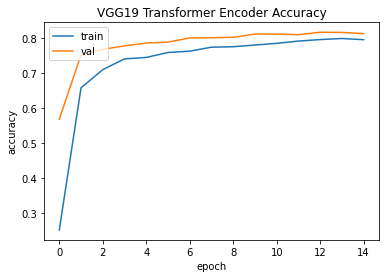

In [ ]:
plot_accuracy('VGG19 Transformer Encoder Accuracy',history)

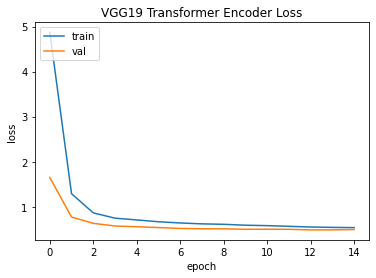

In [ ]:
plot_loss('VGG19 Transformer Encoder Loss',history)

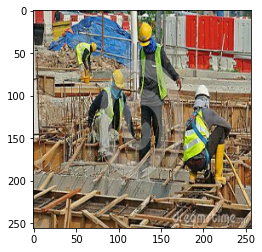

Predicted task:  workers in construction working


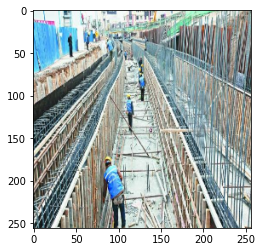

Predicted task:  worker in construction working


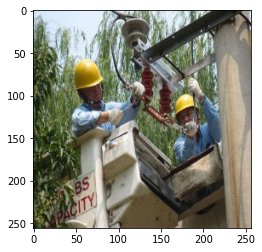

Predicted task:  workers working on electrical equipment


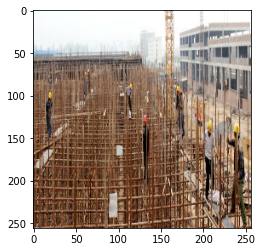

Predicted task:  workers in construction working


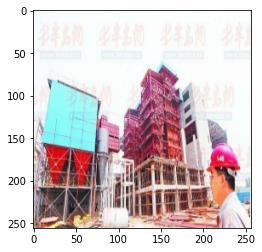

Predicted task:  workers in construction working


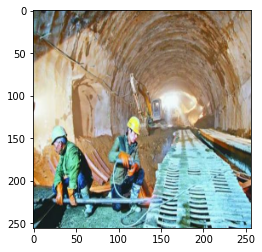

Predicted task:  workers working in a dig


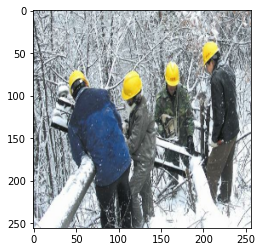

Predicted task:  workers working on electrical equipment


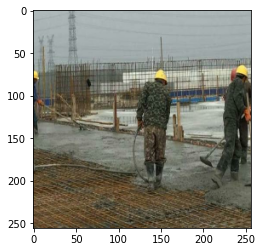

Predicted task:  workers in construction working


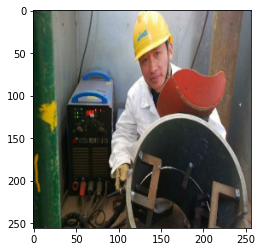

Predicted task:  worker in industry working with hand tool


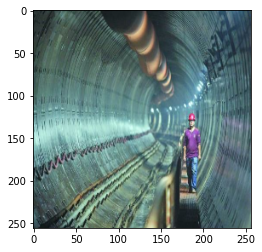

Predicted task:  workers in construction working


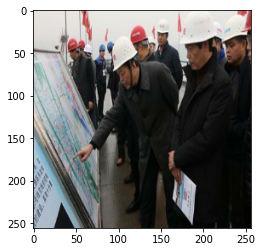

Predicted task:  workers discussing


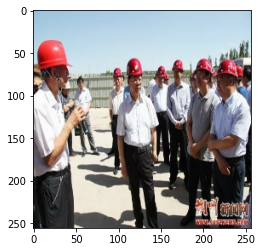

Predicted task:  workers discussing


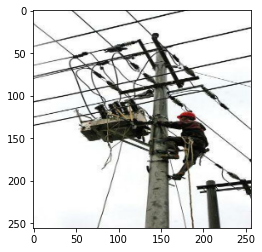

Predicted task:  worker working on electrical equipment


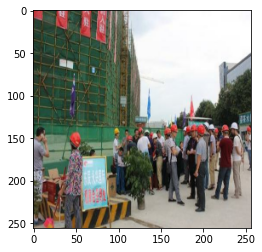

Predicted task:  workers discussing


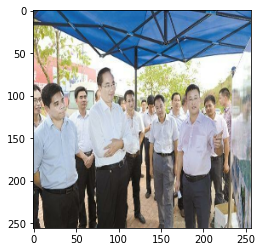

Predicted task:  workers discussing


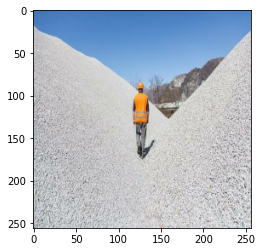

Predicted task:  worker standing


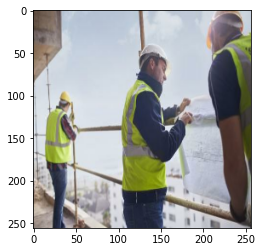

Predicted task:  workers discussing


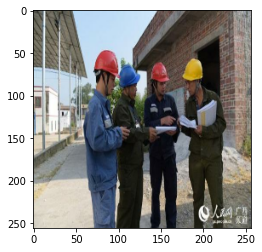

Predicted task:  workers discussing


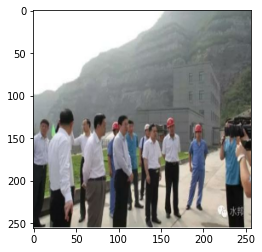

Predicted task:  workers discussing


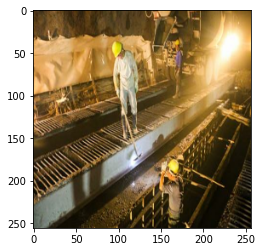

Predicted task:  workers in construction working


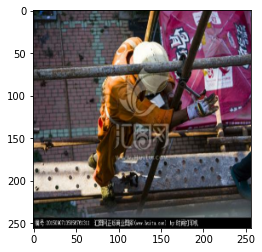

Predicted task:  worker in construction working


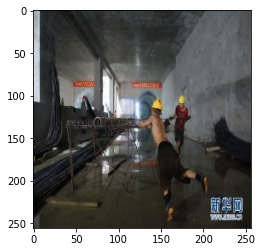

Predicted task:  workers in construction working


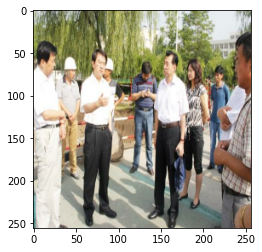

Predicted task:  workers discussing


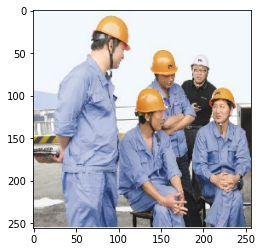

Predicted task:  workers discussing


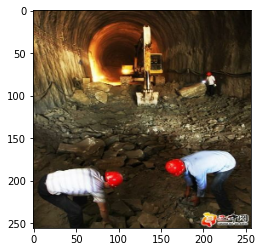

Predicted task:  workers working in a dig


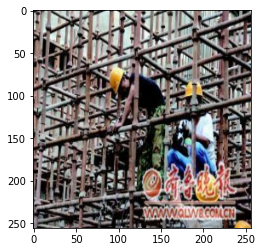

Predicted task:  workers in construction working


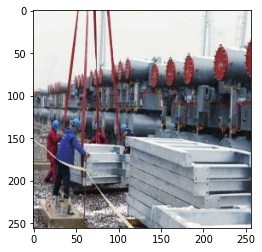

Predicted task:  workers in construction working


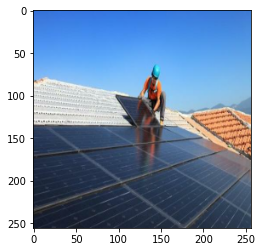

Predicted task:  worker in construction working with hand tool


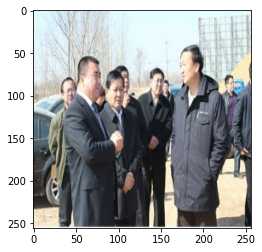

Predicted task:  workers discussing


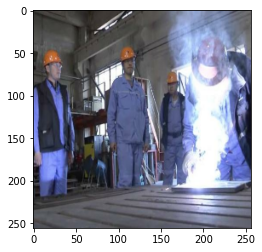

Predicted task:  workers in industry working with hand tool


In [ ]:
# Check predictions for a few samples
for i in range(0,30):
  generate_caption()

### **Implementing Transformer model with pretrained ResNet50**

In [ ]:
def pretrained_resnet50():
    rsnt = resnet50.ResNet50(
        input_shape=(*IMG_SIZE, 3), include_top=False, weights="imagenet",
    )
    # We freeze our feature extractor
    rsnt.trainable = False
    outputs = rsnt.output
    outputs = layers.Reshape((-1, outputs.shape[-1]))(outputs)
    model = keras.models.Model(rsnt.input, outputs)
    return model

In [ ]:
model = pretrained_resnet50()
encoder = TransformerEncoder(embed_dim=EMBED_DIM, dense_dim=FF_DIM, num_heads=1)
decoder = TransformerDecoder(embed_dim=EMBED_DIM, ff_dim=FF_DIM, num_heads=2)
caption_model = TaskIdentification(
    cnn_model=model, encoder=encoder, decoder=decoder, image_aug=image_augmentation,
)

94765736/94765736 [==============================] - 1s 0us/step


In [ ]:
# Compile the model
caption_model.compile(optimizer=keras.optimizers.Adam(lr_schedule), loss=cross_entropy)

# Fit the model
history =caption_model.fit(
    train_dataset,
    epochs=EPOCHS,
    validation_data=valid_dataset,
    callbacks=[early_stopping],
)

Epoch 1/15
50/50 [==============================] - 25s 401ms/step - loss: 4.9173 - acc: 0.1030 - val_loss: 1.6164 - val_acc: 0.5687
Epoch 2/15
50/50 [==============================] - 18s 358ms/step - loss: 1.2493 - acc: 0.6184 - val_loss: 0.7214 - val_acc: 0.7505
Epoch 3/15
50/50 [==============================] - 18s 364ms/step - loss: 0.8004 - acc: 0.7230 - val_loss: 0.5788 - val_acc: 0.7896
Epoch 4/15
50/50 [==============================] - 18s 353ms/step - loss: 0.6701 - acc: 0.7708 - val_loss: 0.5394 - val_acc: 0.8010
Epoch 5/15
50/50 [==============================] - 18s 349ms/step - loss: 0.5921 - acc: 0.7953 - val_loss: 0.5233 - val_acc: 0.8054
Epoch 6/15
50/50 [==============================] - 18s 349ms/step - loss: 0.5244 - acc: 0.8129 - val_loss: 0.5369 - val_acc: 0.8044
Epoch 7/15
50/50 [==============================] - 18s 353ms/step - loss: 0.4500 - acc: 0.8375 - val_loss: 0.5656 - val_acc: 0.8046
Epoch 8/15
50/50 [==============================] - 18s 354ms/step - 

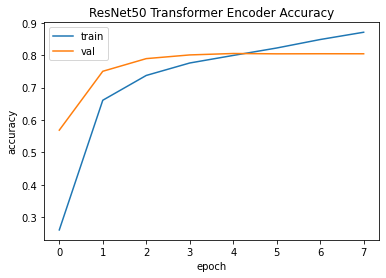

In [ ]:
plot_accuracy('ResNet50 Transformer Encoder Accuracy',history)

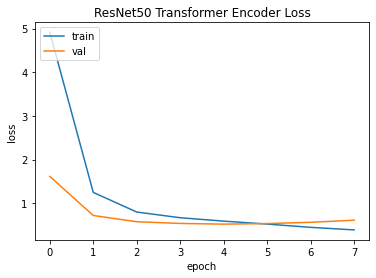

In [ ]:
plot_loss('ResNet50 Transformer Encoder Loss',history)

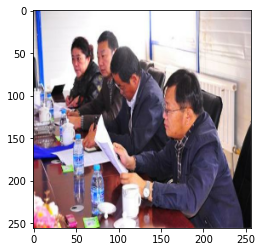

Predicted task:  workers discussing


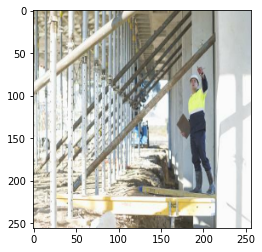

Predicted task:  workers in construction working


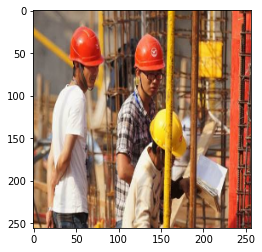

Predicted task:  workers discussing


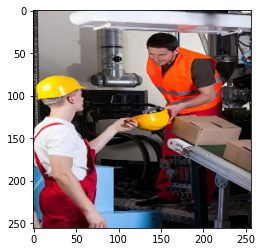

Predicted task:  worker in industry working with power tool


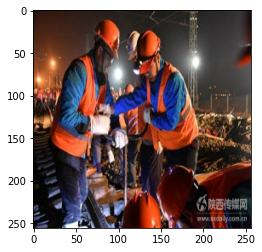

Predicted task:  workers in construction working


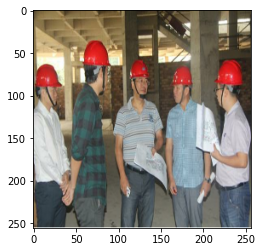

Predicted task:  workers discussing


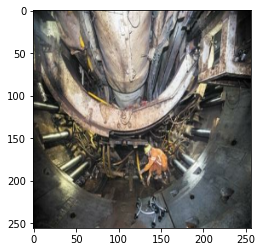

Predicted task:  workers working in a dig


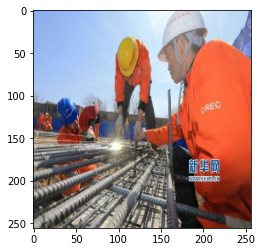

Predicted task:  workers in construction working


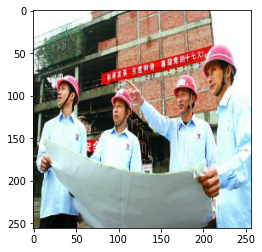

Predicted task:  workers discussing


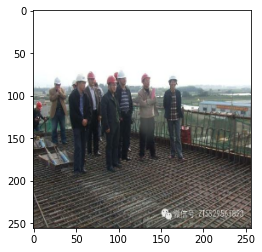

Predicted task:  workers standing


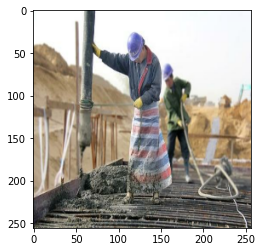

Predicted task:  workers in construction working


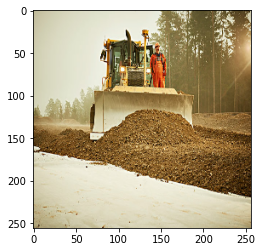

Predicted task:  worker in construction working


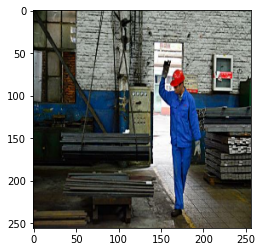

Predicted task:  worker in construction working


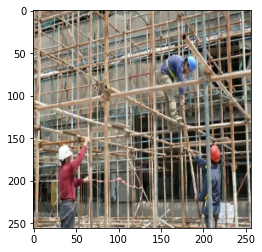

Predicted task:  workers in construction working


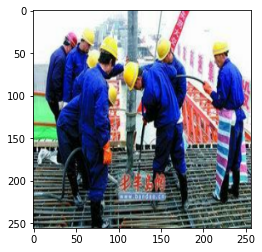

Predicted task:  workers in construction working


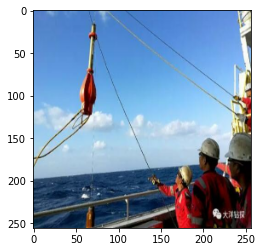

Predicted task:  workers in construction working


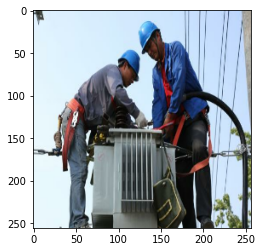

Predicted task:  workers working on electrical equipment


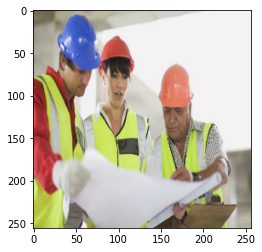

Predicted task:  workers discussing


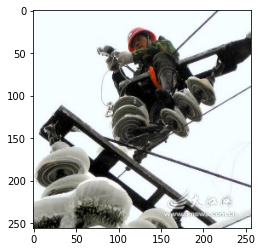

Predicted task:  worker working on electrical equipment


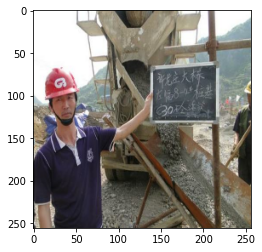

Predicted task:  workers discussing


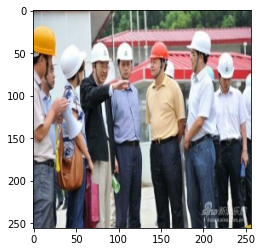

Predicted task:  workers discussing


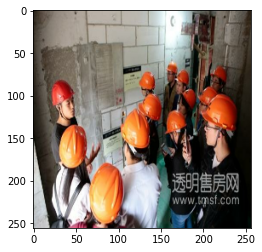

Predicted task:  workers discussing


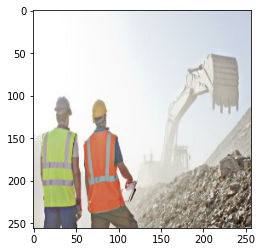

Predicted task:  workers discussing


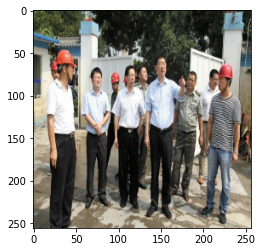

Predicted task:  workers discussing


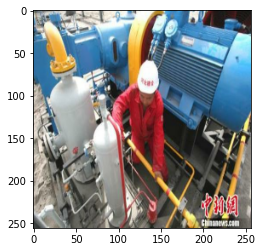

Predicted task:  workers working on electrical equipment


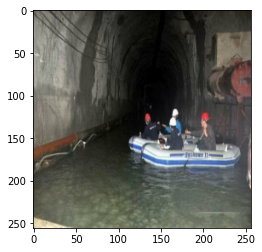

Predicted task:  workers in construction working with hand tool


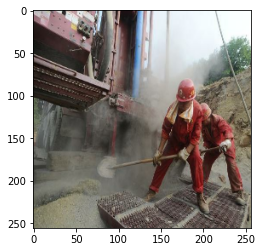

Predicted task:  workers in construction working


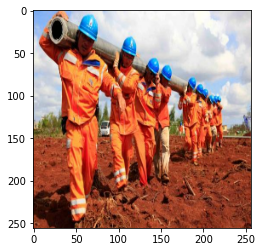

Predicted task:  workers in construction working


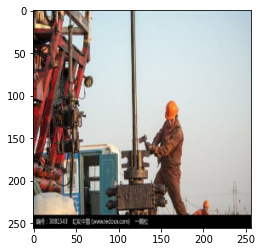

Predicted task:  worker working on electrical equipment


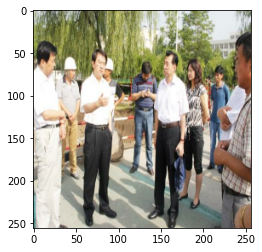

Predicted task:  workers discussing


In [ ]:
# Check predictions for a few samples
for i in range(0,30):
  generate_caption()

### **Implementing Transformer model with pretrained Inception**

In [ ]:
def pretrained_inception_v3():
    incptn = inception_v3.InceptionV3(
        input_shape=(*IMG_SIZE, 3), include_top=False, weights="imagenet",
    )
    # We freeze our feature extractor
    incptn.trainable = False
    outputs = incptn.output
    outputs = layers.Reshape((-1, outputs.shape[-1]))(outputs)
    model = keras.models.Model(incptn.input, outputs)
    return model

In [ ]:
model = pretrained_inception_v3()
encoder = TransformerEncoder(embed_dim=EMBED_DIM, dense_dim=FF_DIM, num_heads=1)
decoder = TransformerDecoder(embed_dim=EMBED_DIM, ff_dim=FF_DIM, num_heads=2)
caption_model = TaskIdentification(
    cnn_model=model, encoder=encoder, decoder=decoder, image_aug=image_augmentation,
)

87910968/87910968 [==============================] - 0s 0us/step


In [ ]:
# Compile the model
caption_model.compile(optimizer=keras.optimizers.Adam(lr_schedule), loss=cross_entropy)

# Fit the model
history =caption_model.fit(
    train_dataset,
    epochs=EPOCHS,
    validation_data=valid_dataset,
    callbacks=[early_stopping],
)

Epoch 1/15
50/50 [==============================] - 23s 333ms/step - loss: 4.7139 - acc: 0.1045 - val_loss: 1.6149 - val_acc: 0.5800
Epoch 2/15
50/50 [==============================] - 14s 278ms/step - loss: 1.3145 - acc: 0.6116 - val_loss: 0.8301 - val_acc: 0.7074
Epoch 3/15
50/50 [==============================] - 14s 276ms/step - loss: 0.9397 - acc: 0.6731 - val_loss: 0.7347 - val_acc: 0.7213
Epoch 4/15
50/50 [==============================] - 14s 270ms/step - loss: 0.8499 - acc: 0.6920 - val_loss: 0.6797 - val_acc: 0.7410
Epoch 5/15
50/50 [==============================] - 14s 275ms/step - loss: 0.7930 - acc: 0.7094 - val_loss: 0.6543 - val_acc: 0.7353
Epoch 6/15
50/50 [==============================] - 14s 269ms/step - loss: 0.7596 - acc: 0.7137 - val_loss: 0.6506 - val_acc: 0.7430
Epoch 7/15
50/50 [==============================] - 14s 273ms/step - loss: 0.7288 - acc: 0.7258 - val_loss: 0.6489 - val_acc: 0.7427
Epoch 8/15
50/50 [==============================] - 14s 275ms/step - 

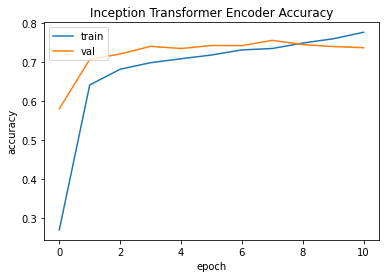

In [ ]:
plot_accuracy('Inception Transformer Encoder Accuracy',history)

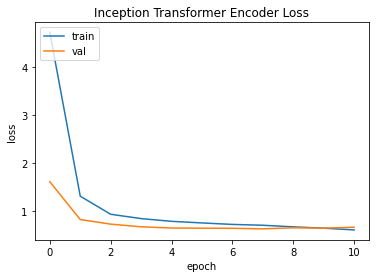

In [ ]:
plot_loss('Inception Transformer Encoder Loss',history)

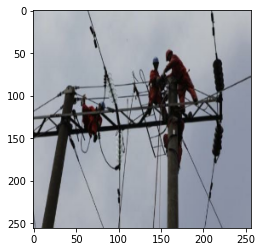

Predicted task:  workers discussing


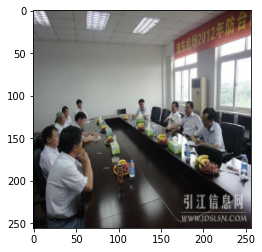

Predicted task:  workers discussing


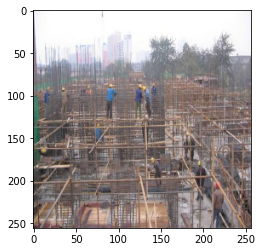

Predicted task:  workers in construction working


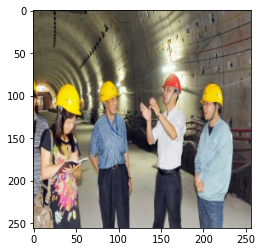

Predicted task:  workers discussing


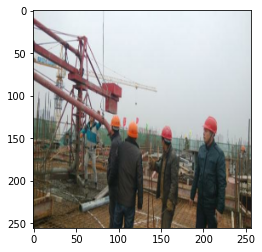

Predicted task:  workers in construction working


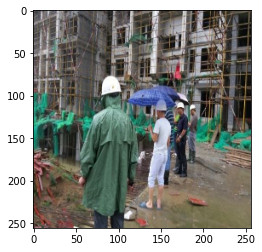

Predicted task:  workers in construction working


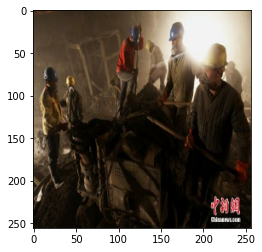

Predicted task:  workers working in a dig with hand tool


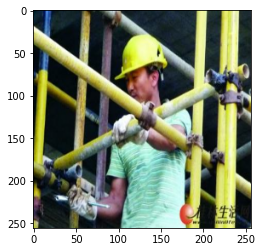

Predicted task:  workers working on electrical equipment


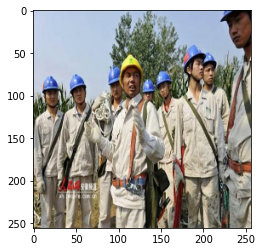

Predicted task:  workers working on electrical equipment


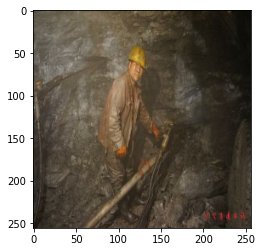

Predicted task:  workers working on electrical equipment


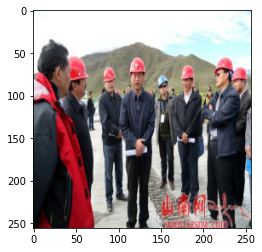

Predicted task:  workers discussing


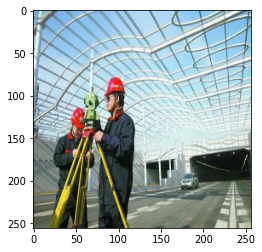

Predicted task:  workers working on electrical equipment


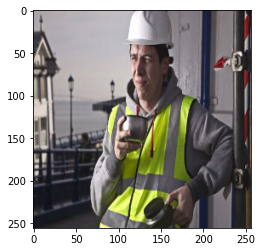

Predicted task:  workers discussing


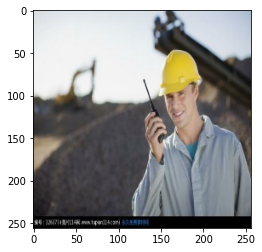

Predicted task:  workers in construction working with hand tool


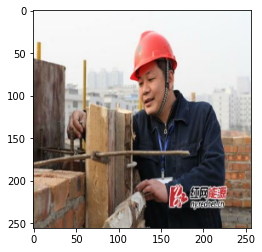

Predicted task:  workers discussing


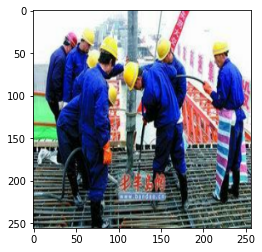

Predicted task:  workers working on electrical equipment


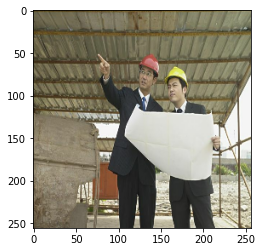

Predicted task:  workers discussing


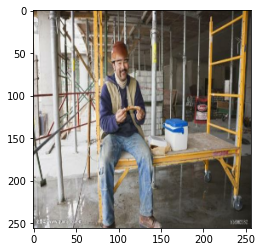

Predicted task:  workers in construction working with hand tool


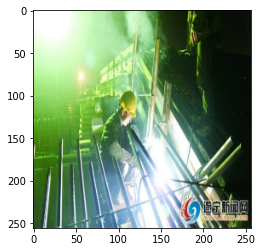

Predicted task:  workers in construction working with hand tool


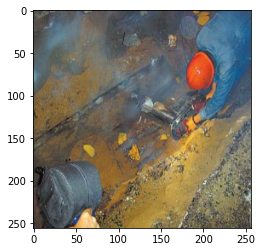

Predicted task:  workers in construction working with hand tool


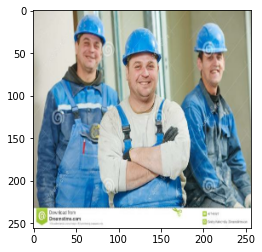

Predicted task:  workers discussing


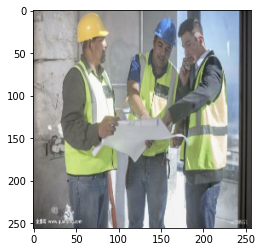

Predicted task:  workers discussing


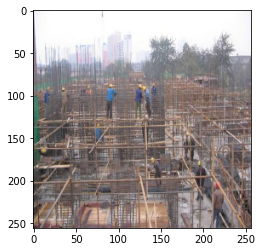

Predicted task:  workers in construction working


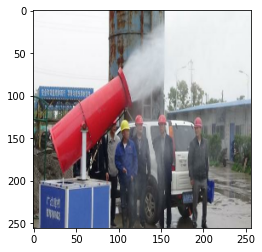

Predicted task:  workers in construction working


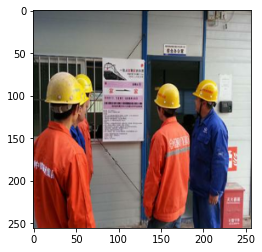

Predicted task:  workers discussing


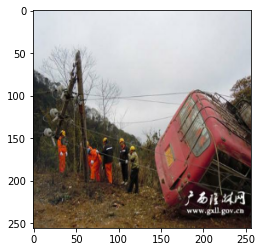

Predicted task:  workers working on electrical equipment


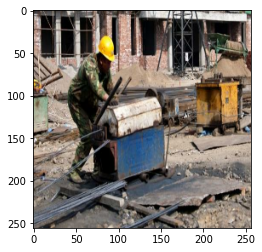

Predicted task:  workers discussing


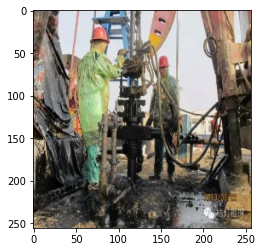

Predicted task:  workers in construction working


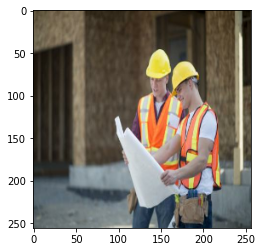

Predicted task:  workers discussing


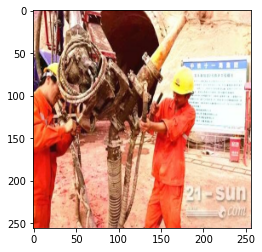

Predicted task:  workers discussing


In [ ]:
# Check predictions for a few samples
for i in range(0,30):
  generate_caption()

### **Implementing Transformer model with pretrained Xception**

In [ ]:
def pretrained_xception():
    xcept = xception.Xception(
        input_shape=(*IMG_SIZE, 3), include_top=False, weights="imagenet",
    )
    # We freeze our feature extractor
    xcept.trainable = False
    outputs = xcept.output
    outputs = layers.Reshape((-1, outputs.shape[-1]))(outputs)
    model = keras.models.Model(xcept.input, outputs)
    return model

In [ ]:
model = pretrained_xception()
encoder = TransformerEncoder(embed_dim=EMBED_DIM, dense_dim=FF_DIM, num_heads=1)
decoder = TransformerDecoder(embed_dim=EMBED_DIM, ff_dim=FF_DIM, num_heads=2)
caption_model = TaskIdentification(
    cnn_model=model, encoder=encoder, decoder=decoder, image_aug=image_augmentation,
)

83683744/83683744 [==============================] - 0s 0us/step


In [ ]:
# Compile the model
caption_model.compile(optimizer=keras.optimizers.Adam(lr_schedule), loss=cross_entropy)

# Fit the model
history =caption_model.fit(
    train_dataset,
    epochs=EPOCHS,
    validation_data=valid_dataset,
    callbacks=[early_stopping],
)

Epoch 1/15
50/50 [==============================] - 33s 544ms/step - loss: 5.0059 - acc: 0.0883 - val_loss: 1.6683 - val_acc: 0.5550
Epoch 2/15
50/50 [==============================] - 24s 482ms/step - loss: 1.3282 - acc: 0.6130 - val_loss: 0.8502 - val_acc: 0.6933
Epoch 3/15
50/50 [==============================] - 24s 481ms/step - loss: 0.9499 - acc: 0.6752 - val_loss: 0.7459 - val_acc: 0.7132
Epoch 4/15
50/50 [==============================] - 25s 490ms/step - loss: 0.8633 - acc: 0.6778 - val_loss: 0.6922 - val_acc: 0.7342
Epoch 5/15
50/50 [==============================] - 24s 481ms/step - loss: 0.7961 - acc: 0.7094 - val_loss: 0.6470 - val_acc: 0.7555
Epoch 6/15
50/50 [==============================] - 25s 496ms/step - loss: 0.7459 - acc: 0.7214 - val_loss: 0.6322 - val_acc: 0.7489
Epoch 7/15
50/50 [==============================] - 24s 469ms/step - loss: 0.7224 - acc: 0.7247 - val_loss: 0.6427 - val_acc: 0.7413
Epoch 8/15
50/50 [==============================] - 25s 500ms/step - 

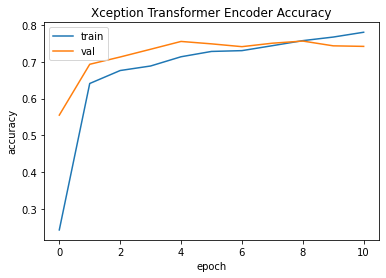

In [ ]:
plot_accuracy('Xception Transformer Encoder Accuracy',history)

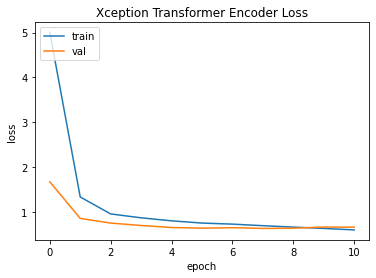

In [ ]:
plot_loss('Xception Transformer Encoder Loss',history)

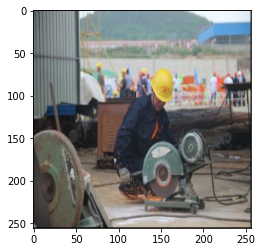

Predicted task:  workers in construction working


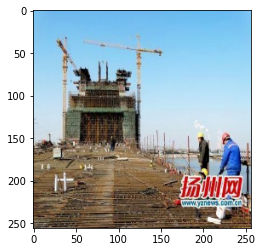

Predicted task:  workers in construction working with hand tool


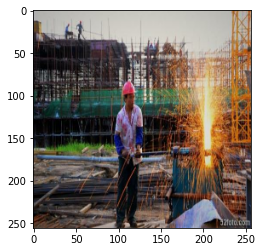

Predicted task:  workers in construction working


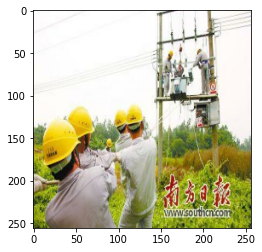

Predicted task:  workers working on electrical equipment


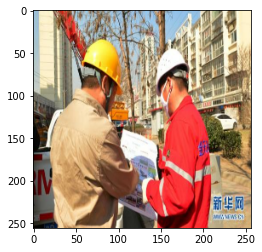

Predicted task:  workers working on electrical equipment


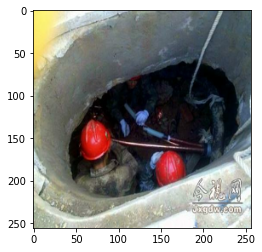

Predicted task:  workers in construction working


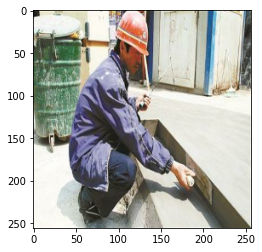

Predicted task:  workers working on electrical equipment


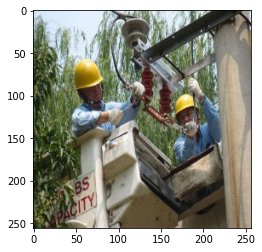

Predicted task:  workers working on electrical equipment


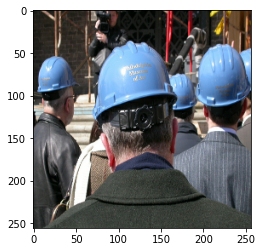

Predicted task:  workers working on electrical equipment


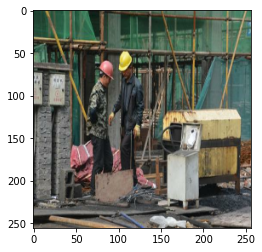

Predicted task:  workers in construction working


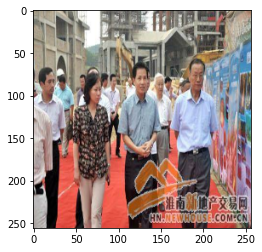

Predicted task:  workers working on electrical equipment


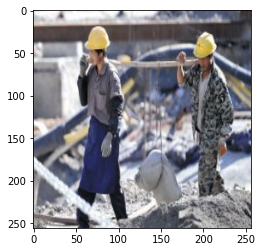

Predicted task:  workers working on electrical equipment


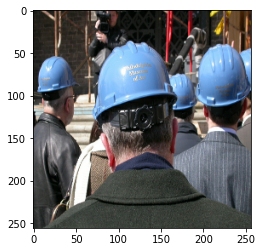

Predicted task:  workers working on electrical equipment


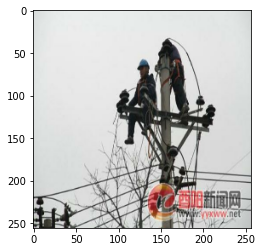

Predicted task:  workers working on electrical equipment


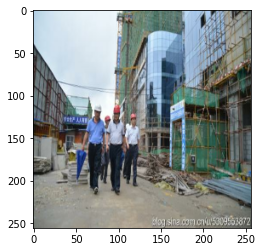

Predicted task:  workers working on electrical equipment


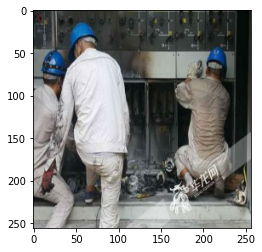

Predicted task:  workers working on electrical equipment


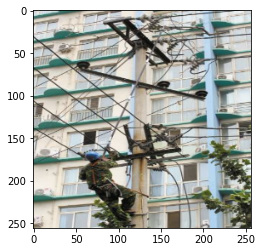

Predicted task:  workers working on electrical equipment


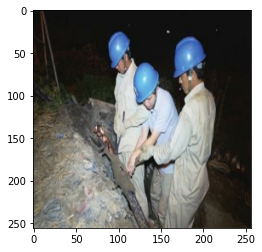

Predicted task:  workers discussing


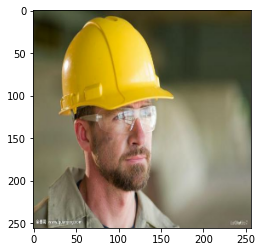

Predicted task:  worker working on electrical equipment


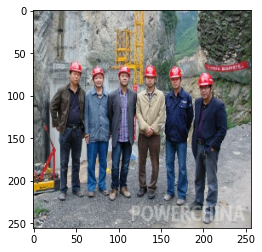

Predicted task:  workers in construction working


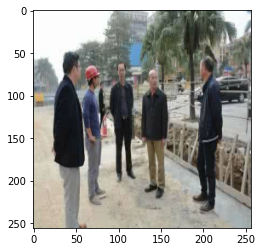

Predicted task:  workers discussing


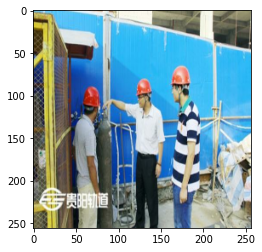

Predicted task:  workers working on electrical equipment


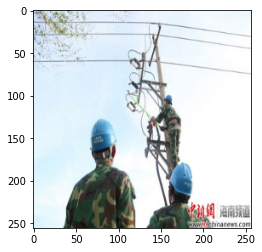

Predicted task:  workers working on electrical equipment


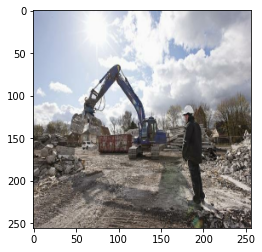

Predicted task:  workers in construction working with hand tool


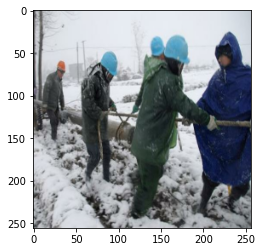

Predicted task:  workers discussing


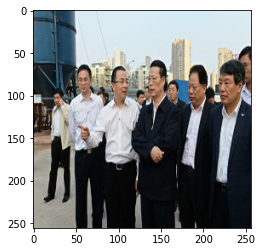

Predicted task:  workers discussing


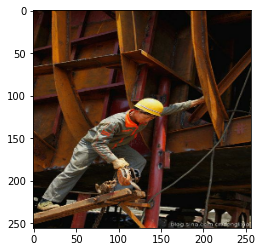

Predicted task:  workers working on industrial equipment


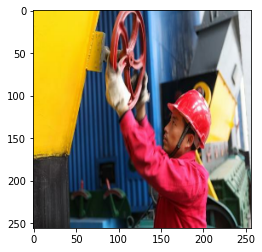

Predicted task:  workers in construction working with hand tool


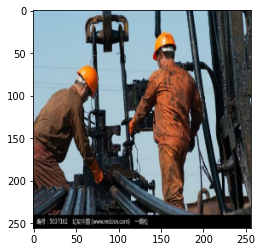

Predicted task:  workers working on electrical equipment


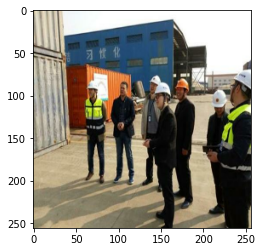

Predicted task:  workers discussing


In [ ]:
# Check predictions for a few samples
for i in range(0,30):
  generate_caption()

### **Implementing Transformer model with pretrained EfficientNet**

In [ ]:
def pretrained_efficientnet():
    effnet = efficientnet.EfficientNetB0(
        input_shape=(*IMG_SIZE, 3), include_top=False, weights="imagenet",
    )
    # We freeze our feature extractor
    effnet.trainable = False
    outputs = effnet.output
    outputs = layers.Reshape((-1, outputs.shape[-1]))(outputs)
    model = keras.models.Model(effnet.input, outputs)
    return model

In [ ]:
model = pretrained_efficientnet()
encoder = TransformerEncoder(embed_dim=EMBED_DIM, dense_dim=FF_DIM, num_heads=1)
decoder = TransformerDecoder(embed_dim=EMBED_DIM, ff_dim=FF_DIM, num_heads=2)
caption_model = TaskIdentification(
    cnn_model=model, encoder=encoder, decoder=decoder, image_aug=image_augmentation,
)

16705208/16705208 [==============================] - 0s 0us/step


In [ ]:
# Compile the model
caption_model.compile(optimizer=keras.optimizers.Adam(lr_schedule), loss=cross_entropy)

# Fit the model
history =caption_model.fit(
    train_dataset,
    epochs=EPOCHS,
    validation_data=valid_dataset,
    callbacks=[early_stopping],
)

Epoch 1/15
50/50 [==============================] - 22s 315ms/step - loss: 5.1140 - acc: 0.0914 - val_loss: 1.7571 - val_acc: 0.5814
Epoch 2/15
50/50 [==============================] - 14s 274ms/step - loss: 1.2878 - acc: 0.6182 - val_loss: 0.7255 - val_acc: 0.7532
Epoch 3/15
50/50 [==============================] - 14s 271ms/step - loss: 0.7939 - acc: 0.7368 - val_loss: 0.5678 - val_acc: 0.7969
Epoch 4/15
50/50 [==============================] - 14s 269ms/step - loss: 0.6608 - acc: 0.7748 - val_loss: 0.5194 - val_acc: 0.8083
Epoch 5/15
50/50 [==============================] - 14s 270ms/step - loss: 0.5839 - acc: 0.8010 - val_loss: 0.5254 - val_acc: 0.8173
Epoch 6/15
50/50 [==============================] - 14s 285ms/step - loss: 0.5237 - acc: 0.8195 - val_loss: 0.5117 - val_acc: 0.8166
Epoch 7/15
50/50 [==============================] - 13s 266ms/step - loss: 0.4655 - acc: 0.8449 - val_loss: 0.5230 - val_acc: 0.8148
Epoch 8/15
50/50 [==============================] - 16s 316ms/step - 

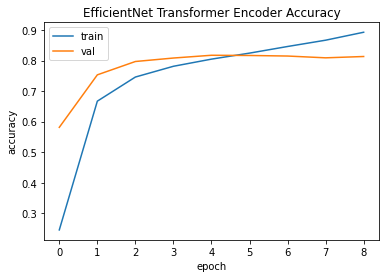

In [ ]:
plot_accuracy('EfficientNet Transformer Encoder Accuracy',history)

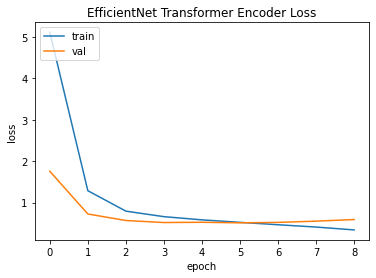

In [ ]:
plot_loss('EfficientNet Transformer Encoder Loss',history)

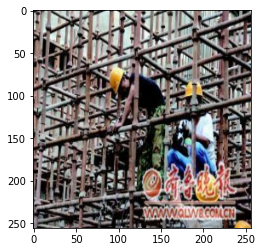

Predicted task:  workers working on industrial equipment


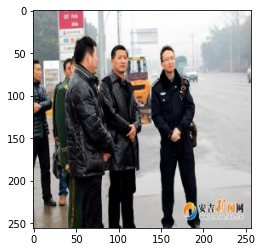

Predicted task:  workers discussing


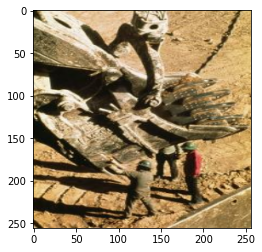

Predicted task:  workers in construction working with hand tool


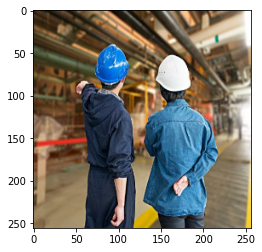

Predicted task:  workers discussing


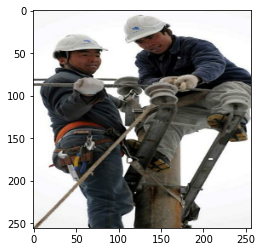

Predicted task:  workers working on industrial equipment


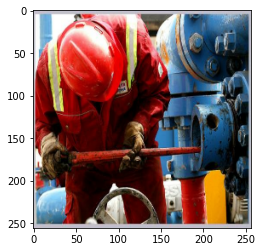

Predicted task:  worker working on industrial equipment


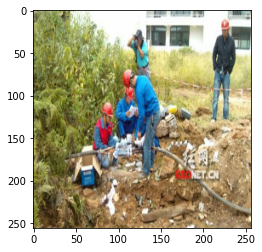

Predicted task:  workers in construction working with hand tool


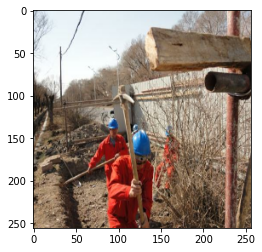

Predicted task:  workers working on electrical equipment


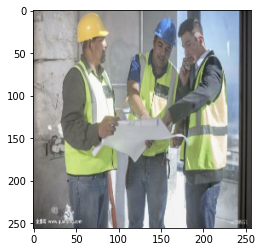

Predicted task:  workers discussing


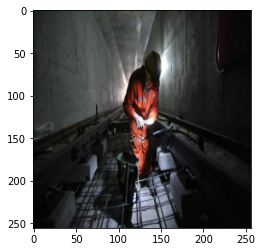

Predicted task:  worker in construction working with hand tool


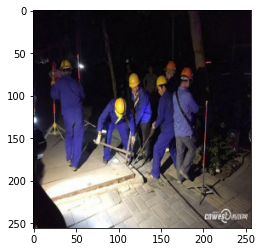

Predicted task:  workers in construction working with hand tool


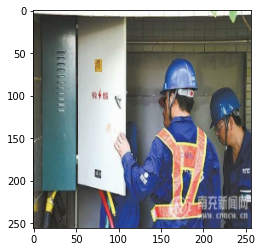

Predicted task:  workers discussing


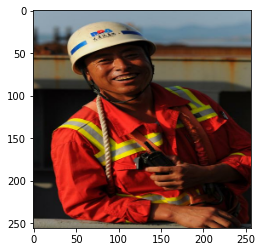

Predicted task:  workers in construction working


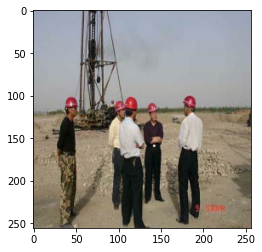

Predicted task:  workers discussing


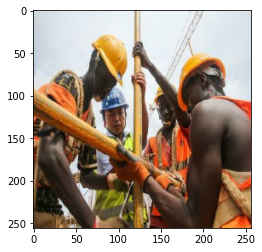

Predicted task:  workers in construction working


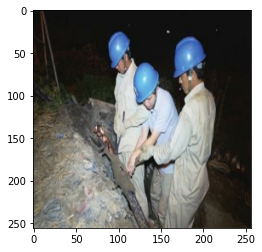

Predicted task:  workers in construction working with hand tool


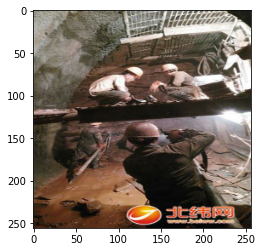

Predicted task:  workers in construction working with hand tool


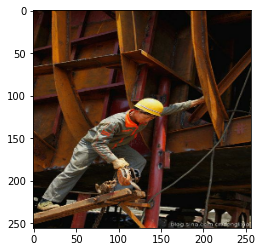

Predicted task:  workers in construction working


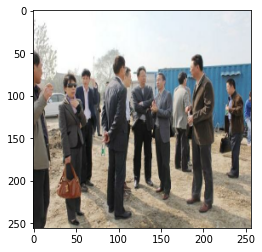

Predicted task:  workers discussing


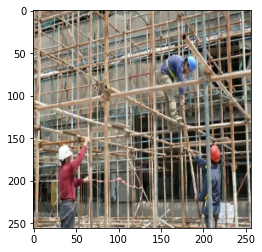

Predicted task:  workers in construction working


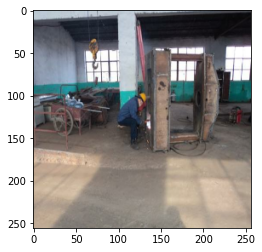

Predicted task:  workers in construction working


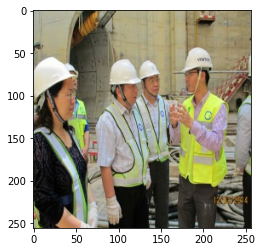

Predicted task:  workers discussing


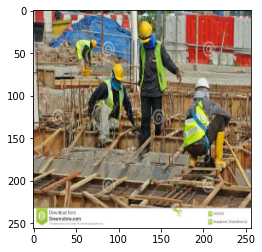

Predicted task:  workers in construction working with hand tool


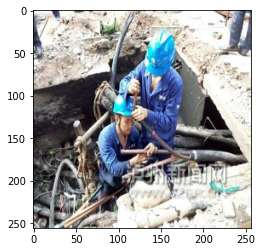

Predicted task:  workers in construction working with hand tool


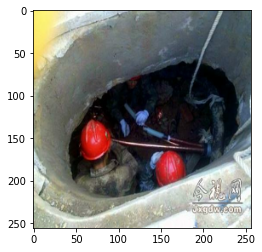

Predicted task:  workers in construction working with hand tool


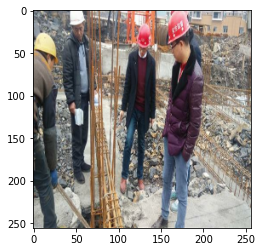

Predicted task:  workers discussing


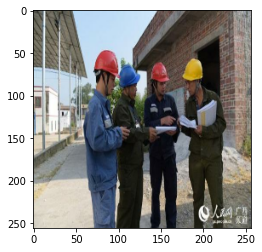

Predicted task:  workers discussing


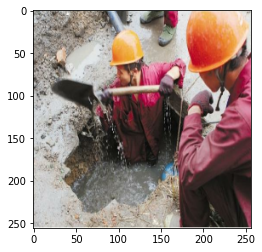

Predicted task:  workers in construction working with hand tool


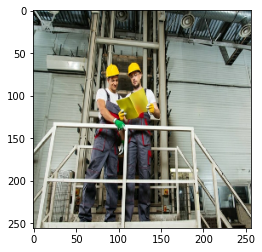

Predicted task:  workers discussing


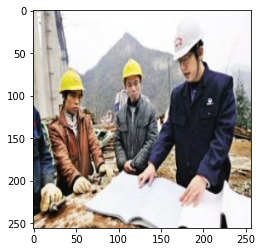

Predicted task:  workers discussing


In [ ]:
# Check predictions for a few samples
for i in range(0,30):
  generate_caption()